In [1]:
import torch
from IPython.display import Image  # for displaying images
import os 
import random
import shutil
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET
from xml.dom import minidom
from tqdm import tqdm
from PIL import Image, ImageDraw, ImageFont
import numpy as np
import matplotlib.pyplot as plt

random.seed(420)

/cluster/home/henrfj/ProjectTDT17/yolo_env/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [56]:
# Function to get the data from XML Annotation
def extract_info_from_xml(xml_file):
    root = ET.parse(xml_file).getroot()
    
    # Initialise the info dict 
    info_dict = {}
    info_dict['bboxes'] = []

    # Parse the XML Tree
    for elem in root:
        # Get the file name 
        if elem.tag == "filename":
            info_dict['filename'] = elem.text
        # Get the image size
        elif elem.tag == "size":
            image_size = []
            for i, subelem in enumerate(elem):
                if i<2: #for some reason, no depth data in the xmls!
                    image_size.append(int(subelem.text))
                else: 
                    image_size.append(int(3))
            
            info_dict['image_size'] = tuple(image_size)
        
        # Get details of the bounding box 
        elif elem.tag == "object":
            bbox = {}
            for subelem in elem:
                if subelem.tag == "name":
                    bbox["class"] = subelem.text
                    
                elif subelem.tag == "bndbox":
                    for subsubelem in subelem:
                        bbox[subsubelem.tag] = int(float(subsubelem.text)) # need to cast to float, before anything else!
            info_dict['bboxes'].append(bbox)
    
    return info_dict

In [57]:
print(extract_info_from_xml('data/train/annotations/xmls/Norway_002967.xml'))


{'bboxes': [{'class': 'D00', 'xmin': 1462, 'ymin': 1143, 'xmax': 1511, 'ymax': 1268}, {'class': 'D10', 'xmin': 89, 'ymin': 1445, 'xmax': 1719, 'ymax': 1647}, {'class': 'D10', 'xmin': 664, 'ymin': 1361, 'xmax': 1661, 'ymax': 1480}, {'class': 'D00', 'xmin': 1460, 'ymin': 1301, 'xmax': 1813, 'ymax': 2027}, {'class': 'D10', 'xmin': 13, 'ymin': 1610, 'xmax': 1826, 'ymax': 1814}], 'filename': 'Norway_002967.jpg', 'image_size': (3643, 2041, 3)}


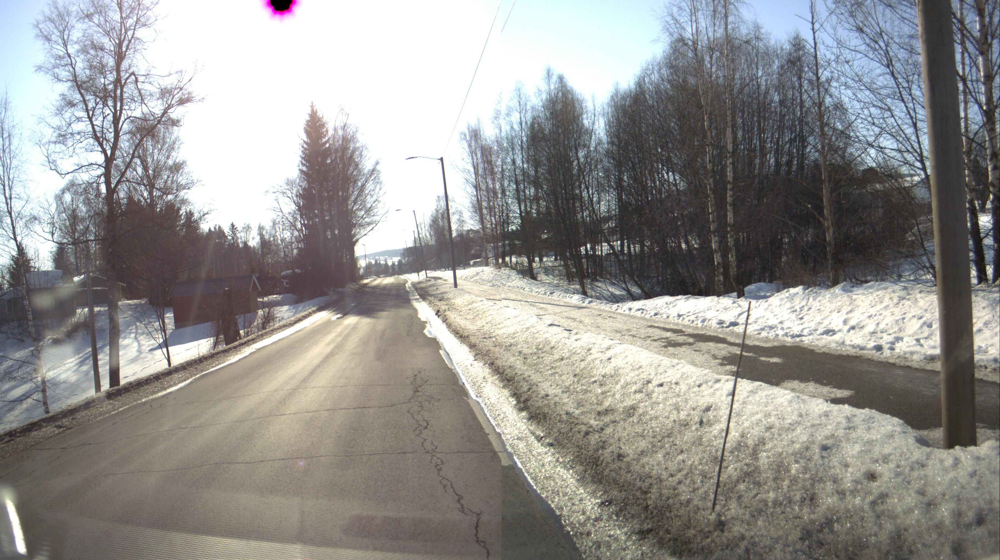

In [3]:
from PIL import Image

image = Image.open('data/train/images/Norway_002967.jpg')
image


In [59]:
# Dictionary that maps class names to IDs
class_name_to_id_mapping = {"D00": 0,# longitudinal
                           "D10": 1, # transversal
                           "D20": 2, # aligator
                           "D40": 3} # pothole

path = '/cluster/home/henrfj/ProjectTDT17/data/train/annotations/xmls'

# Convert the info dict to the required yolo format and write it to disk
def convert_to_yolov5(info_dict):
    print_buffer = []
    
    # For each bounding box
    for b in info_dict["bboxes"]:
        try:
            class_id = class_name_to_id_mapping[b["class"]]
        except KeyError:
            print("Invalid Class. Must be one from ", class_name_to_id_mapping.keys())
        
        # Transform the bbox co-ordinates as per the format required by YOLO v5
        b_center_x = (b["xmin"] + b["xmax"]) / 2 
        b_center_y = (b["ymin"] + b["ymax"]) / 2
        b_width    = (b["xmax"] - b["xmin"])
        b_height   = (b["ymax"] - b["ymin"])
        
        # Normalise the co-ordinates by the dimensions of the image
        image_w, image_h, image_c = info_dict["image_size"]  
        b_center_x /= image_w 
        b_center_y /= image_h 
        b_width    /= image_w 
        b_height   /= image_h 
        
        #Write the bbox details to the file 
        print_buffer.append("{} {:.3f} {:.3f} {:.3f} {:.3f}".format(class_id, b_center_x, b_center_y, b_width, b_height))
        
    # Name of the file which we have to save 
    save_file_name = os.path.join(path, info_dict["filename"].replace("jpg", "txt"))
    
    # Save the annotation to disk
    print("\n".join(print_buffer), file= open(save_file_name, "w"))

In [60]:
# Get the annotations
annotations = [os.path.join(path, x) for x in os.listdir(path) if x[-3:] == "xml"]
annotations.sort()


In [61]:
# Convert and save the annotations
for ann in tqdm(annotations):
    info_dict = extract_info_from_xml(ann)
    convert_to_yolov5(info_dict)

100%|██████████| 8161/8161 [00:11<00:00, 735.86it/s]


In [62]:
annotations = [os.path.join(path, x) for x in os.listdir(path) if x[-3:] == "txt"]

/cluster/home/henrfj/ProjectTDT17/data/train/annotations/xmls/Norway_000728.txt
/cluster/home/henrfj/ProjectTDT17/data/train/images/Norway_000728.jpg


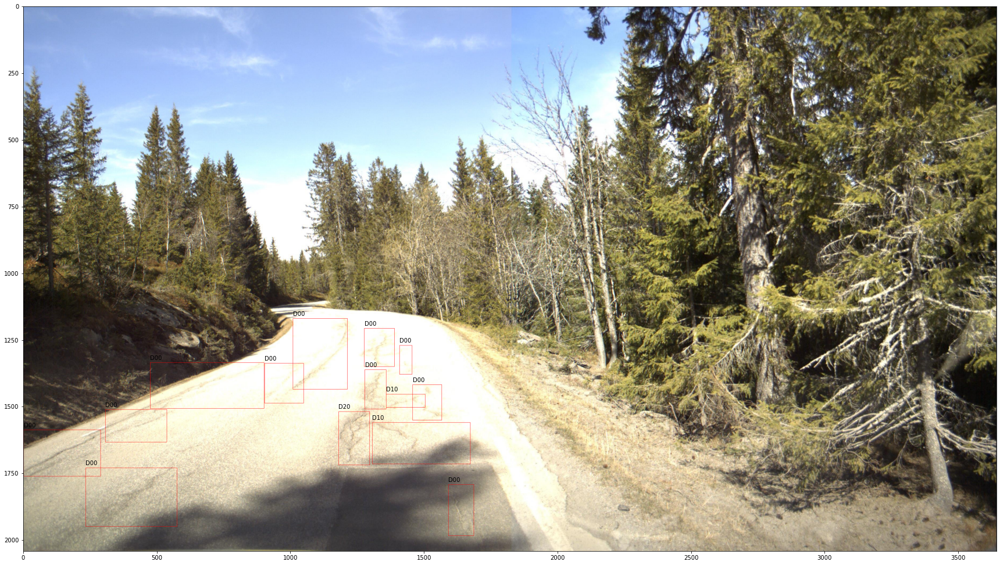

In [90]:
plt.rcParams['figure.figsize'] = [30, 30]

class_id_to_name_mapping = dict(zip(class_name_to_id_mapping.values(), class_name_to_id_mapping.keys()))

def plot_bounding_box(image, annotation_list):
    annotations = np.array(annotation_list)
    w, h = image.size
    
    plotted_image = ImageDraw.Draw(image)

    transformed_annotations = np.copy(annotations)
    transformed_annotations[:,[1,3]] = annotations[:,[1,3]] * w
    transformed_annotations[:,[2,4]] = annotations[:,[2,4]] * h 
    
    transformed_annotations[:,1] = transformed_annotations[:,1] - (transformed_annotations[:,3] / 2)
    transformed_annotations[:,2] = transformed_annotations[:,2] - (transformed_annotations[:,4] / 2)
    transformed_annotations[:,3] = transformed_annotations[:,1] + transformed_annotations[:,3]
    transformed_annotations[:,4] = transformed_annotations[:,2] + transformed_annotations[:,4]
    
    for ann in transformed_annotations:
        obj_cls, x0, y0, x1, y1 = ann
        plotted_image.rectangle(((x0,y0), (x1,y1)), outline="red")

        #plotted_image.text((x0, y0 - 10), class_id_to_name_mapping[(int(obj_cls))])
        plt.text(x0, y0 - 10, s=class_id_to_name_mapping[(int(obj_cls))])
    
    
    plt.imshow(np.array(image))
    #plt.text(x0, y0 - 10, s="test")
    #plt.figure(figsize=(100, 100), dpi=80)
    plt.show()

# Get a annotation file
annotation_file = '/cluster/home/henrfj/ProjectTDT17/data/train/annotations/xmls/Norway_000728.txt'
print(annotation_file)
with open(annotation_file, "r") as file:
    annotation_list = file.read().split("\n")[:-1]
    annotation_list = [x.split(" ") for x in annotation_list]
    annotation_list = [[float(y) for y in x ] for x in annotation_list]

#Get the corresponding image file
image_file = '/cluster/home/henrfj/ProjectTDT17/data/train/images/Norway_000728.jpg'
print(image_file)
assert os.path.exists(image_file)

#Load the image
image = Image.open(image_file)

#Plot the Bounding Box
plot_bounding_box(image, annotation_list)

### Split into required folders for yoloV5

NB! First we rename the annotations --> labels!

As well as removing the .xml files, as we are only going to use .txt from now.


In [15]:
# Read images and annotations
train_images = [os.path.join('data/train/images', x) for x in os.listdir('data/train/images')]
train_labels = [os.path.join('data/train/labels', x) for x in os.listdir('data/train/labels') if x[-3:] == "txt"]

train_images.sort()
train_labels.sort()

# Split the train-dataset into train-valid splits 
train_images, val_images, train_labels, val_labels = train_test_split(train_images, train_labels, test_size = 0.2, random_state = 42)

**Create new folders under train**: train/val

In [17]:
#Utility function to move images 
def move_files_to_folder(list_of_files, destination_folder):
    for f in list_of_files:
        try:
            shutil.move(f, destination_folder)
        except:
            print(f)
            assert False

In [24]:
# Images
move_files_to_folder(train_images, 'data/train/images/train')
move_files_to_folder(val_images, 'data/train/images/val')

In [25]:
# Labels
move_files_to_folder(train_labels, 'data/train/labels/train')
move_files_to_folder(val_labels, 'data/train/labels/val')

**Training options**


- img: size of images. Images are resized to squares; retaining aspect ratio. Longer side is resized to this number, while short side is padded with gray.
- batch, epochs: as always
- **data**: YAML file with info about dataset (path to images / labels!)
- workers: CPU Workers
- cfg: Model architecture! Can choose from yolo5s.yaml, yolov5m.yaml, yolov5l.yaml, yolov5x.yaml. Own architecture requires a new yaml.
- weights: pretrained weights. From scratch is --weights ' '
- name: "runs/train/name" training log etc.
- **hyp**: yaml file with hyperparameters. data/hyp/scratch.yaml is used by default.


**Data config file**


Defines dataset to be used in a YAML file. In includes:
1. Train, test, val: locations to *images*
2. nc: number of classes
3. names: names of the classes. Index of classes in this list is used.

Make a new road_sign_data.yaml and put it under "yolov5/data".
- Expects names like the ones we have defined udner images and labels! 👌

**Hyperparameter config file**

The hyperparameter config file helps us define the hyperparameters for our neural network. We are going to use the default one, "data/hyp.scratch.yaml". Take a look!

**Custom network architecture**

YOLO v5 also allows you to define your own custom architecture and anchors if one of the pre-defined networks doesn't fit the bill for you. For this you will have to define a custom weights config file. For this example, we use the the **yolov5s.yaml**. This is what it looks like.

To use a custom network, create a new file and specify it at run time using the cfg flag.


### Data config file

Define our own data config file under **yolov5/data/crddc2022.yaml**

### Hyperparameter config file

We are going to add a simple under **yolov5/data/hyp.scratch.yaml**, but other alternatives exists as well.

### About running on SLURM job
https://www.hpc.ntnu.no/idun/getting-started-on-idun/running-jobs/

GPU:
- Add flag --device 0 at the end of python call, to specify **single** GPU.
- Set partition to GPUQ
- Set account to: ie-idi, and time to at least 60(?) hours.

#SBATCH --partition=CPUQ 
#SBATCH --partition=GPUQ     #GPU

Set GPU / specific hardware:
#SBATCH --gres=gpu:1 # Number of GPU's specified

or

#SBATCH --gres=gpu:A100m40:1

16G     P100 \
16G     V100 \
32G     V10032 \
40G     A100m40 \
80G     A100m80



Run on multiple nodes:
#SBATCH --nodes=2
#SBATCH --ntasks-per-node=10


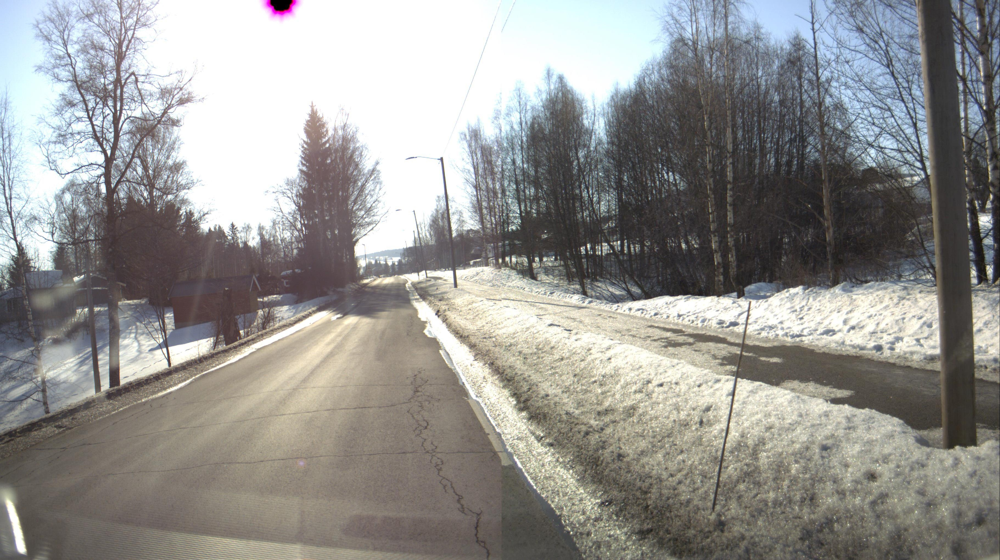

In [2]:
from PIL import Image

image = Image.open('data/train/images/train/Norway_002967.jpg')
image
